<a href="https://colab.research.google.com/github/nandaglhp/PCVK_Ganjil_2023/blob/main/Week8.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

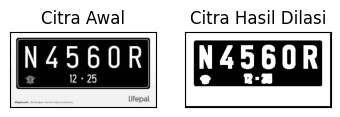

In [4]:
# 3. Buatlah fungsi dilasi serta tampilkan hasil dilasi pada citra dengan Structuring Element
# Dilasi (SED) berbentuk cross 3 x 3 tanpa menggunakan library morphology dari
# openCV, sehingga menghasilkan tampilan seperti di bawah ini:

#Dilasi tanpa library

def dilasi_citra(F,w):
  #size image
  p,q= F.shape

  imgD= np.zeros((p,q), dtype=np.uint8)

  #Generate structure element dilasi (SED)
  SED= np.ones((w,w), dtype=np.uint8)
  constant1= (w-1)//2

  #Proses Dilasi
  for i in range(constant1, p-constant1):
    for j in range(constant1,q-constant1):
      temp= F[i-constant1:i+constant1+1, j-constant1:j+constant1+1]
      product= temp*SED
      imgD[i,j]= np.max(product)
  return imgD

path = '/content/drive/MyDrive/College/05 - Semester 5/PCVK/dataset/plat_nomor.jpeg'
img_d= cv2.imread(path,0)
ret, thresh = cv2.threshold(img_d, 125, 200, cv2.THRESH_BINARY)
w=5
imgD = dilasi_citra(thresh,w)

plt.subplot(131),plt.imshow(img_d,cmap = 'gray')
plt.title('Citra Awal'), plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(imgD,cmap = 'gray')
plt.title('Citra Hasil Dilasi'), plt.xticks([]), plt.yticks([])
plt.show()

[[1 1 1]
 [1 1 1]
 [1 1 1]]


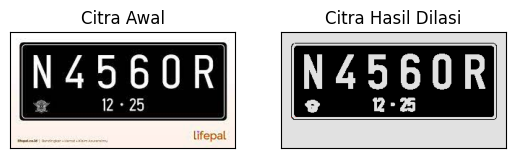

In [5]:
# 4. Buatlah program implementasi operasi dilasi Structuring Element Dilasi (SED)
# berbentuk cross 3 x 3 dengan menggunakan library morphology dari openCV,
# sehingga menghasilkan tampilan seperti di bawah ini:

path = '/content/drive/MyDrive/College/05 - Semester 5/PCVK/dataset/plat_nomor.jpeg'
img = cv2.imread(path)
#img = cv2.imread('morp.jpg',0)
ret, thresh = cv2.threshold(img, 127, 225, cv2.THRESH_BINARY)
kernel = np.ones((3,3),np.uint16)
dilasi = cv2.dilate(thresh,kernel,iterations = 1)
print(kernel)
plt.subplot(121),plt.imshow(img),plt.title('Citra Awal')
plt.xticks([]), plt.yticks([])
plt.subplot(122),plt.imshow(dilasi),plt.title('Citra Hasil Dilasi')
plt.xticks([]), plt.yticks([])
plt.show()

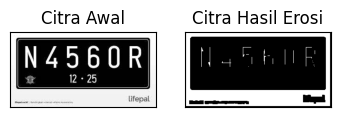

In [6]:
# 5. Buatlah fungsi erosi serta tampilkan hasil erosi pada citra dengan Structuring Element
# Erosi (SE) berbentuk square 5 x 5 tanpa menggunakan library morphology dari
# openCV, sehingga menghasilkan tampilan seperti di bawah ini:

#Erosi Tanpa Library
def erosi_citra(F,k):
  #size image
  m,n= F.shape

  #Generate structure element erosi (SE)
  SE= np.ones((k,k), dtype=np.uint8)
  constant= (k-1)//2

  imgE= np.zeros((m,n), dtype=np.uint8)

  #Proses Erosi
  for i in range(constant, m-constant):
    for j in range(constant,n-constant):
      temp= F[i-constant:i+constant+1, j-constant:j+constant+1]
      product= temp*SE
      imgE[i,j]= np.min(product)

  return imgE

path = '/content/drive/MyDrive/College/05 - Semester 5/PCVK/dataset/plat_nomor.jpeg'
img_e= cv2.imread(path,0)
ret1, thresh1 = cv2.threshold(img_e, 175, 225, cv2.THRESH_BINARY)
k=5
imgE = erosi_citra(thresh1,k)

plt.subplot(131),plt.imshow(img_e,cmap = 'gray')
plt.title('Citra Awal'), plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(imgE,cmap = 'gray')
plt.title('Citra Hasil Erosi'), plt.xticks([]),
plt.yticks([])
plt.show()

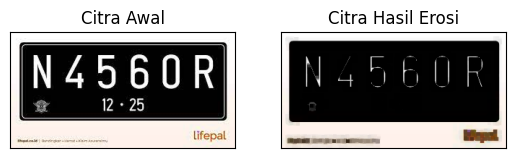

In [7]:
# 6. Buatlah program implementasi operasi dilasi Structuring Element Erosi (SE) berbentuk
# square 5 x 5 dengan menggunakan library morphology dari openCV, sehingga
# menghasilkan tampilan seperti di bawah ini:

# EROSI LIBRARY

path = '/content/drive/MyDrive/College/05 - Semester 5/PCVK/dataset/plat_nomor.jpeg'
img = cv2.imread(path)
kernel = np.ones((5,5),np.uint8)
erosion = cv2.erode(img,kernel,iterations = 1)
plt.subplot(121),plt.imshow(img),plt.title('Citra Awal')
plt.xticks([]), plt.yticks([])
plt.subplot(122),plt.imshow(erosion),plt.title('Citra Hasil Erosi')
plt.xticks([]), plt.yticks([])
plt.show()


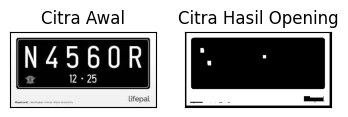

In [8]:
# 7. Buatlah program implementasi operasi opening dengan Structuring Element
# berbentuk square 3 x 3 tanpa dan dengan menggunakan library morphology dari
# openCV, sehingga menghasilkan tampilan seperti di bawah ini:
# Operasi Opening Menggunakan tanpa Library Morphology

path = '/content/drive/MyDrive/College/05 - Semester 5/PCVK/dataset/plat_nomor.jpeg'
img_o= cv2.imread(path,0)
reto, thresho = cv2.threshold(img_o, 127, 225, cv2.THRESH_BINARY)
k=7
imgO = dilasi_citra(erosi_citra(thresho,k),k)

plt.subplot(131),plt.imshow(img_o,cmap = 'gray')
plt.title('Citra Awal'), plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(imgO,cmap = 'gray')
plt.title('Citra Hasil Opening'), plt.xticks([]), plt.yticks([])
plt.show()

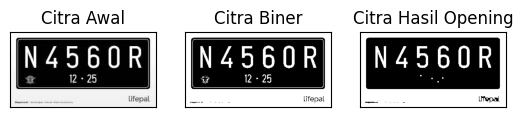

In [9]:
# Operasi Opening Menggunakan Library Morphology
# Dengan Menggunakan Library

path = '/content/drive/MyDrive/College/05 - Semester 5/PCVK/dataset/plat_nomor.jpeg'
img = cv2.imread(path,0)
ret, thresh = cv2.threshold(img, 127, 225, cv2.THRESH_BINARY)
kernel = np.ones((3,3),np.uint8)
openn = cv2.morphologyEx(thresh,cv2.MORPH_OPEN, kernel)
plt.subplot(131),plt.imshow(img,cmap = 'gray')
plt.title('Citra Awal'), plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(thresh,cmap = 'gray')
plt.title('Citra Biner'), plt.xticks([]), plt.yticks([])
plt.subplot(133),plt.imshow(openn,cmap = 'gray')
plt.title('Citra Hasil Opening'), plt.xticks([]),
plt.yticks([])
plt.show()

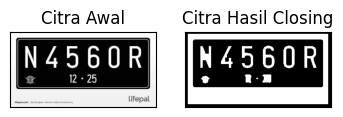

In [10]:
# 8. Buatlah program implementasi operasi closing dengan Structuring Element berbentuk
# square 3 x 3 tanpa dan dengan menggunakan library morphology dari openCV,
# sehingga menghasilkan tampilan seperti di bawah ini:
# operasi closing tanpa library morphology

path = '/content/drive/MyDrive/College/05 - Semester 5/PCVK/dataset/plat_nomor.jpeg'
img_c= cv2.imread(path,0)
retc, threshc = cv2.threshold(img_c, 127, 225, cv2.THRESH_BINARY)
k=7
imgC = erosi_citra(dilasi_citra(threshc,k) ,k)

plt.subplot(131),plt.imshow(img_c,cmap = 'gray')
plt.title('Citra Awal'), plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(imgC,cmap = 'gray')
plt.title('Citra Hasil Closing'), plt.xticks([]),
plt.yticks([])
plt.show()

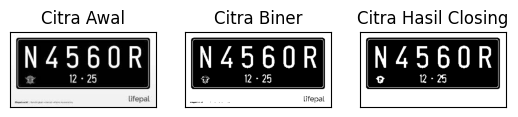

In [11]:
# operasi closing dengan library morphology
img = cv2.imread(path,0)
ret, thresh = cv2.threshold(img, 127, 225, cv2.THRESH_BINARY)
kernel = np.ones((3,3),np.uint8)
closs = cv2.morphologyEx(thresh,cv2.MORPH_CLOSE, kernel)
plt.subplot(131),plt.imshow(img,cmap = 'gray')
plt.title('Citra Awal'), plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(thresh,cmap = 'gray')
plt.title('Citra Biner'), plt.xticks([]), plt.yticks([])
plt.subplot(133),plt.imshow(closs,cmap = 'gray')
plt.title('Citra Hasil Closing'), plt.xticks([]), plt.yticks([])
plt.show()

SED = Cross 3


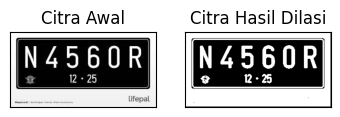

SED = Cross 5


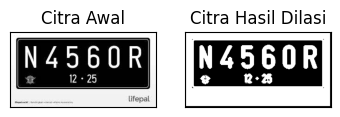

In [12]:
# 9. Buatlah program implementasi operasi dilasi dengan Structuring Element berbentuk
# Cross 3 x 3 dan 5 x 5

#Dilasi Cross SED
def dilasi_citra(F,w):
  #size image
  p,q= F.shape

  imgD= np.zeros((p,q), dtype=np.uint8)
  #Generate structure element dilasi (SED)
  # SED= np.ones((w,w), dtype=np.uint8)
  SED = np.array([[0, 1, 0],
                  [1, 1, 1],
                  [0, 1, 0]], dtype = np.uint8)
  constant1= (w-1)//2

  #Proses Dilasi
  for i in range(constant1, p-constant1):
    for j in range(constant1,q-constant1):
      temp= F[i-constant1:i+constant1+1, j-constant1:j+constant1+1]
      product= temp*SED
      imgD[i,j]= np.max(product)
  return imgD
print('SED = Cross 3')
img_d= cv2.imread(path,0)
ret, thresh = cv2.threshold(img_d, 127, 225, cv2.THRESH_BINARY)
w=3
imgD = dilasi_citra(thresh,w)

plt.subplot(131),plt.imshow(img_d,cmap = 'gray')
plt.title('Citra Awal'), plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(imgD,cmap = 'gray')
plt.title('Citra Hasil Dilasi'), plt.xticks([]),
plt.yticks([])
plt.show()

def dilasi_citra(F,w):
#size image
  p,q= F.shape

  imgD= np.zeros((p,q), dtype=np.uint8)

  #Generate structure element dilasi (SED)
  # SED= np.ones((w,w), dtype=np.uint8)
  SED = np.array([[0, 0, 1, 0, 0],
                  [0, 0, 1, 0, 0],
                  [1, 1, 1, 1, 1],
                  [0, 0, 1, 0, 0],
                  [0, 0, 1, 0, 0]], dtype = np.uint8)
  constant1= (w-1)//2
  #Proses Dilasi
  for i in range(constant1, p-constant1):
    for j in range(constant1,q-constant1):
      temp= F[i-constant1:i+constant1+1, j-constant1:j+constant1+1]
      product= temp*SED
      imgD[i,j]= np.max(product)
  return imgD
print('SED = Cross 5')
img_d= cv2.imread(path,0)
ret, thresh = cv2.threshold(img_d, 127, 225, cv2.THRESH_BINARY)
w=5
imgD = dilasi_citra(thresh,w)

plt.subplot(131),plt.imshow(img_d,cmap = 'gray')
plt.title('Citra Awal'), plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(imgD,cmap = 'gray')
plt.title('Citra Hasil Dilasi'), plt.xticks([]),
plt.yticks([])
plt.show()

SED = Circle 3


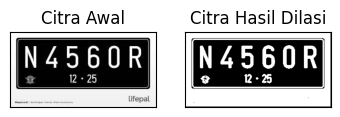

SED = Circle 5


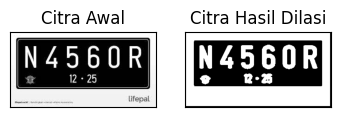

In [13]:
# 10. Buatlah program implementasi operasi dilasi dengan Structuring Element berbentuk
# Circular 3 x 3 dan 5 x 5, sehingga menghasilkan tampilan seperti di bawah ini:

# Dilasi Circular SED

def dilasi_citra(F,w):
  #size image
  p,q= F.shape

  imgD= np.zeros((p,q), dtype=np.uint8)

  #Generate structure element dilasi (SED)
  SED= cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(w,w))
  constant1= (w-1)//2
  #Proses Dilasi
  for i in range(constant1, p-constant1):
    for j in range(constant1,q-constant1):
      temp= F[i-constant1:i+constant1+1, j-constant1:j+constant1+1]
      product= temp*SED
      imgD[i,j]= np.max(product)
  return imgD
print('SED = Circle 3')
img_d= cv2.imread(path,0)
ret, thresh = cv2.threshold(img_d, 127, 225, cv2.THRESH_BINARY)
w=3
imgD = dilasi_citra(thresh,w)
plt.subplot(131),plt.imshow(img_d,cmap = 'gray')
plt.title('Citra Awal'), plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(imgD,cmap = 'gray')
plt.title('Citra Hasil Dilasi'), plt.xticks([]),
plt.yticks([])
plt.show()
print('SED = Circle 5')
img_d= cv2.imread(path,0)
ret, thresh = cv2.threshold(img_d, 127, 225, cv2.THRESH_BINARY)
w=5
imgD = dilasi_citra(thresh,w)
plt.subplot(131),plt.imshow(img_d,cmap = 'gray')
plt.title('Citra Awal'), plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(imgD,cmap = 'gray')
plt.title('Citra Hasil Dilasi'), plt.xticks([]),
plt.yticks([])
plt.show()

SE = Rectangle 3x5


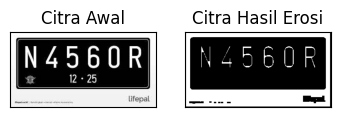

SE = Rectangle 5x7


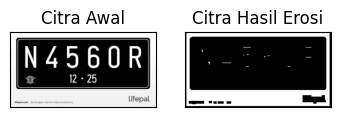

In [14]:
# 11. Buatlah program implementasi operasi erosi dengan Structuring Element berbentuk
# Rectangle 3 x 5 dan 5 x 7, sehingga menghasilkan tampilan seperti di bawah ini:

# Erosi Cross SE

def erosi_citra(F,p,l):
  #size image
  m,n= F.shape

  #Generate structure element erosi (SE)
  SE = cv2.getStructuringElement(cv2.MORPH_RECT,(p,l)) #SE persegi panjang
  constant1= (l-1)//2
  constant2= (p-1)//2
  # print(SE)
  imgE= np.zeros((m,n), dtype=np.uint8)

  #Proses Erosi
  for i in range(constant1, m-constant1):
    for j in range(constant2,n-constant2):
      temp= F[i-constant1:i+constant1+1, j-constant2:j+constant2+1]
      product= temp*SE
      imgE[i,j]= np.min(product)

  return imgE
print('SE = Rectangle 3x5')
img_e= cv2.imread(path,0) #
ret1, thresh1 = cv2.threshold(img_e, 127, 225, cv2.THRESH_BINARY)
p=5
l=3
imgE = erosi_citra(thresh1,p,l)

plt.subplot(131),plt.imshow(img_e,cmap = 'gray')
plt.title('Citra Awal'), plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(imgE,cmap = 'gray')
plt.title('Citra Hasil Erosi'), plt.xticks([]), plt.yticks([])
plt.show()
print('SE = Rectangle 5x7')
img_e= cv2.imread(path,0) #
ret1, thresh1 = cv2.threshold(img_e, 127, 225, cv2.THRESH_BINARY)
p=7
l=5
imgE = erosi_citra(thresh1,p,l)
plt.subplot(131),plt.imshow(img_e,cmap = 'gray')
plt.title('Citra Awal'), plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(imgE,cmap = 'gray')
plt.title('Citra Hasil Erosi'), plt.xticks([]), plt.yticks([])
plt.show()

SE = Line Vertikal 3


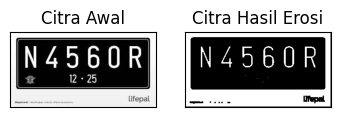

SE = Line Vertikal 5


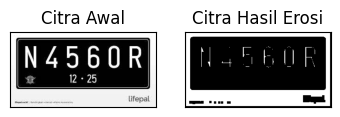

In [15]:
# 12. Buatlah program implementasi operasi erosi dengan Structuring Element berbentuk
# Line Vertikal 3 dan 5, sehingga menghasilkan tampilan seperti di bawah ini: (Gunakan
# gambar j.png)

# Erosi Line Vertikal SE

def erosi_citra(F,k):
  #size image
  m,n= F.shape

  #Generate structure element erosi (SE)
  SE = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(1,k)) #SE line vertikal
  constant= (k-1)//2

  imgE= np.zeros((m,n), dtype=np.uint8)

  #Proses Erosi
  for i in range(constant, m-constant):
    for j in range(constant,n-constant):
      temp= F[i-constant:i+constant+1, j-constant:j+constant+1]
      product= temp*SE
      imgE[i,j]= np.min(product)

  return imgE
print('SE = Line Vertikal 3')
img_e= cv2.imread(path,0) #
ret1, thresh1 = cv2.threshold(img_e, 127, 225,
cv2.THRESH_BINARY)
k=3
imgE = erosi_citra(thresh1,k)

plt.subplot(131),plt.imshow(img_e,cmap = 'gray')
plt.title('Citra Awal'), plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(imgE,cmap = 'gray')
plt.title('Citra Hasil Erosi'), plt.xticks([]),
plt.yticks([])
plt.show()

print('SE = Line Vertikal 5')
img_e= cv2.imread(path,0) #
ret1, thresh1 = cv2.threshold(img_e, 127, 225,
cv2.THRESH_BINARY)
k=5
imgE = erosi_citra(thresh1,k)

plt.subplot(131),plt.imshow(img_e,cmap = 'gray')
plt.title('Citra Awal'), plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(imgE,cmap = 'gray')
plt.title('Citra Hasil Erosi'), plt.xticks([]),
plt.yticks([])
plt.show()



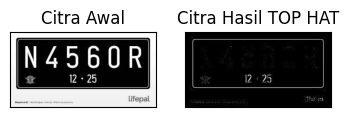

In [16]:
# 13 TopHat

# Getting the kernel to be used in Top-Hat
filterSize =(3, 3)
kernel = cv2.getStructuringElement(cv2.MORPH_RECT,filterSize)

# Reading the image named 'input.jpg'
img = cv2.imread(path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Applying the Top-Hat operation
tophat_img = cv2.morphologyEx(img,cv2.MORPH_TOPHAT,kernel)

#cv2.imshow("original", input_image)
#cv2.imshow("tophat", tophat_img)
#cv2.waitKey(5000)
plt.subplot(131),plt.imshow(img,cmap = 'gray')
plt.title('Citra Awal'), plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(tophat_img,cmap = 'gray')
plt.title('Citra Hasil TOP HAT'), plt.xticks([]), plt.yticks([])
plt.show()

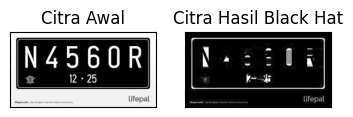

In [17]:
# 14 BLACKHAT

filterSize =(3, 3)
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, filterSize)

# Reading the image named 'input.jpg'
img = cv2.imread(path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Applying the Black-Hat operation
#tophat_img = cv2.morphologyEx(img,cv2.MORPH_BLACKHAT, kernel)
Kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (13, 5))
blackhat = cv2.morphologyEx(img, cv2.MORPH_BLACKHAT, Kernel)
#cv2.imshow("original", input_image)
#cv2.imshow("tophat", tophat_img)
#cv2.waitKey(5000)
plt.subplot(131),plt.imshow(img,cmap = 'gray')
plt.title('Citra Awal'), plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(blackhat,cmap = 'gray')
plt.title('Citra Hasil Black Hat'), plt.xticks([]), plt.yticks([])
plt.show()


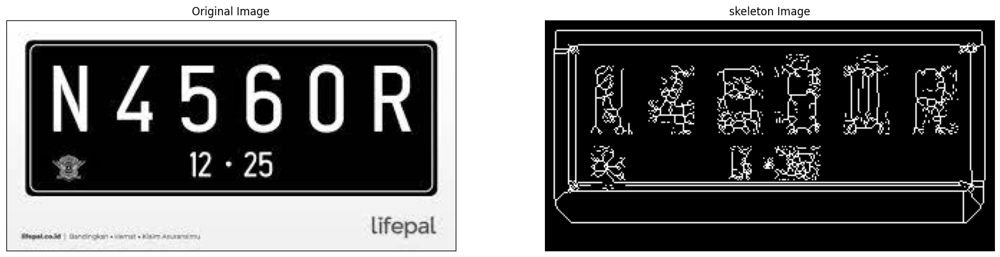

In [18]:
# 15. Skeleton

import cv2 as cv
from matplotlib import pyplot as plt
from skimage import filters

from skimage.morphology import skeletonize

# read image
img = cv.imread(path,0)

binary = img > filters.threshold_triangle(img)

# true false to one
binary_cp = binary.copy()
binary_cp[binary_cp == True] = 1
binary_cp[binary_cp == False] = 0

# skeletonize image
skeleton = skeletonize(binary_cp)

# print images
plt.figure(figsize=(20,20))

plt.subplot(121),plt.imshow(img,cmap = 'gray')
plt.title('Original Image'), plt.xticks([]), plt.yticks([])

plt.subplot(122),plt.imshow(skeleton,cmap = 'gray')
plt.title('skeleton Image'), plt.xticks([]), plt.yticks([])

plt.savefig("binary and bin_skeleton.png")
plt.show()

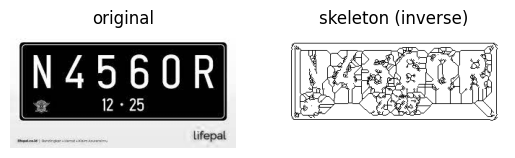

In [19]:
# 16. Skeleton Inverse

from skimage import io
from matplotlib import pyplot as plt
from skimage import filters
from skimage.morphology import skeletonize

# read image
img = io.imread(path)[...,0]
# Note: we want the black bits to be True, so use <
binary = img < filters.threshold_triangle(img)
# skeletonize image
skeleton = skeletonize(binary)
# print images
fig, ax = plt.subplots(1, 2)
ax[0].imshow(img, cmap='gray')
ax[0].set_title('original')
ax[0].set_axis_off()
# note the reversed colormap, gray_r
ax[1].imshow(skeleton, cmap='gray_r')
ax[1].set_title('skeleton (inverse)')
ax[1].set_axis_off()
plt.show()


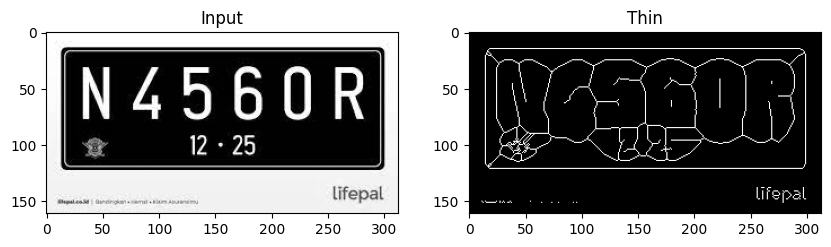

In [20]:
# 17. Thickening

from skimage import img_as_float
from skimage import io, color, morphology
import matplotlib.pyplot as plt

image = img_as_float(color.rgb2gray(io.imread(path)))
image_binary = image < 0.5
out_skeletonize = morphology.skeletonize(image_binary)
out_thin = morphology.thin(image_binary)
f, (ax0, ax1) = plt.subplots(1, 2, figsize=(10, 3))
ax0.imshow(image, cmap='gray')
ax0.set_title('Input')
ax1.imshow(out_thin, cmap='gray')
ax1.set_title('Thin')
plt.savefig('/tmp/char_out.png')
plt.show()

### Tugas Praktikum

In [21]:
# Impor library
import numpy as np  # Impor perpustakaan NumPy untuk operasi numerik.
import cv2  # Impor OpenCV untuk pengolahan gambar.
import matplotlib.pyplot as plt  # Impor Matplotlib untuk visualisasi.
from google.colab.patches import cv2_imshow  # Impor cv2_imshow dari Google Colab untuk menampilkan gambar.
from sklearn.cluster import KMeans  # Impor KMeans dari scikit-learn untuk pengelompokan data.
import os  # Impor modul os untuk fungsi sistem operasi.
import random  # Impor modul random untuk menghasilkan angka acak.
import matplotlib.pyplot as plt  # Impor Matplotlib lagi untuk visualisasi.


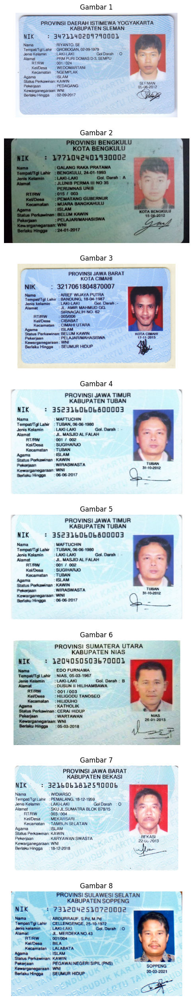

In [23]:
direct_data = '/content/drive/MyDrive/College/05 - Semester 5/PCVK/KTP_More'

# Dapatkan daftar file gambar dalam direktori dataset
image_files = [os.path.join(direct_data, file) for file in os.listdir(direct_data)]

# Inisialisasi subplot untuk menampilkan gambar dalam satu kolom
num_images = len(image_files)

# Set ukuran plot dan kolom
fig, ax = plt.subplots(num_images, 1, figsize=(8, 4*num_images))

for i, image_path in enumerate(image_files):
    # Baca gambar
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Tampilkan gambar di subplot yang sesuai
    ax[i].imshow(image)
    ax[i].set_title(f'Gambar {i+1}')
    ax[i].axis('off')

plt.show()

### Dilasi

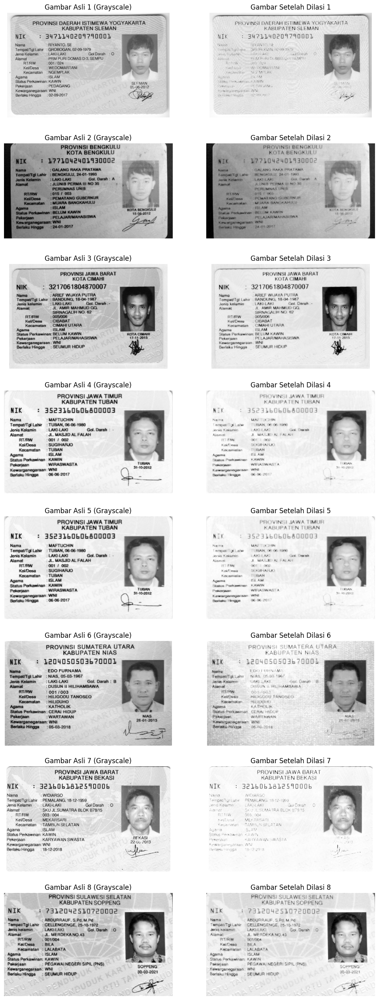

In [24]:
direct_data = '/content/drive/MyDrive/College/05 - Semester 5/PCVK/KTP_More'

# Dapatkan daftar file gambar dalam direktori dataset
image_files = [os.path.join(direct_data, file) for file in os.listdir(direct_data)]

# Inisialisasi subplot untuk menampilkan gambar dalam satu kolom
num_images = len(image_files)

# Set ukuran plot dan kolom
fig, ax = plt.subplots(num_images, 2, figsize=(12, 4*num_images))  # Dua kolom: gambar asli dan gambar setelah dilasi

for i, image_path in enumerate(image_files):
    # Baca gambar
    image = cv2.imread(image_path)

    # Ubah gambar menjadi skala abu-abu (grayscale)
    grayscale_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Melakukan dilasi pada gambar skala abu-abu
    kernel = np.ones((3, 3), np.uint8)  # Ukuran kernel dilasi (bisa disesuaikan)
    dilated_image = cv2.dilate(grayscale_image, kernel, iterations=1)

    # Tampilkan gambar asli di subplot pertama
    ax[i, 0].imshow(grayscale_image, cmap='gray')
    ax[i, 0].set_title(f'Gambar Asli {i+1} (Grayscale)')
    ax[i, 0].axis('off')

    # Tampilkan gambar setelah dilasi di subplot kedua
    ax[i, 1].imshow(dilated_image, cmap='gray')
    ax[i, 1].set_title(f'Gambar Setelah Dilasi {i+1}')
    ax[i, 1].axis('off')

plt.show()


### Erosi

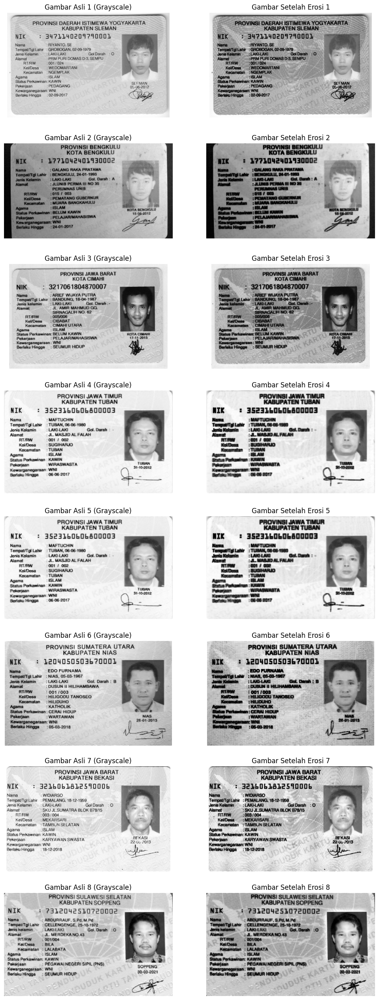

In [25]:
direct_data = '/content/drive/MyDrive/College/05 - Semester 5/PCVK/KTP_More'

# Dapatkan daftar file gambar dalam direktori dataset
image_files = [os.path.join(direct_data, file) for file in os.listdir(direct_data)]

# Inisialisasi subplot untuk menampilkan gambar dalam satu kolom
num_images = len(image_files)

# Set ukuran plot dan kolom
fig, ax = plt.subplots(num_images, 2, figsize=(12, 4*num_images))  # Dua kolom: gambar asli dan gambar setelah erosi

for i, image_path in enumerate(image_files):
    # Baca gambar
    image = cv2.imread(image_path)

    # Ubah gambar menjadi skala abu-abu (grayscale)
    grayscale_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Melakukan erosi pada gambar skala abu-abu
    kernel = np.ones((3, 3), np.uint8)  # Ukuran kernel erosi (bisa disesuaikan)
    eroded_image = cv2.erode(grayscale_image, kernel, iterations=1)

    # Tampilkan gambar asli di subplot pertama
    ax[i, 0].imshow(grayscale_image, cmap='gray')
    ax[i, 0].set_title(f'Gambar Asli {i+1} (Grayscale)')
    ax[i, 0].axis('off')

    # Tampilkan gambar setelah erosi di subplot kedua
    ax[i, 1].imshow(eroded_image, cmap='gray')
    ax[i, 1].set_title(f'Gambar Setelah Erosi {i+1}')
    ax[i, 1].axis('off')

plt.show()


### Opening

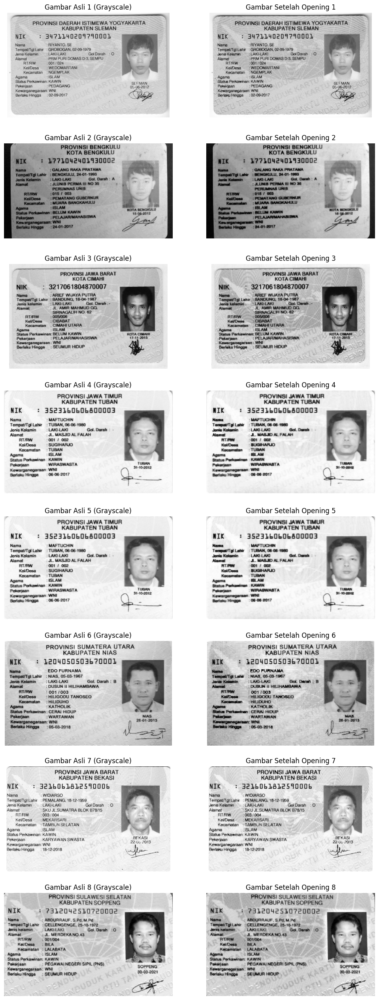

In [26]:
direct_data = '/content/drive/MyDrive/College/05 - Semester 5/PCVK/KTP_More'

# Dapatkan daftar file gambar dalam direktori dataset
image_files = [os.path.join(direct_data, file) for file in os.listdir(direct_data)]

# Inisialisasi subplot untuk menampilkan gambar dalam satu kolom
num_images = len(image_files)

# Set ukuran plot dan kolom
fig, ax = plt.subplots(num_images, 2, figsize=(12, 4*num_images))  # Dua kolom: gambar asli dan gambar setelah Opening

for i, image_path in enumerate(image_files):
    # Baca gambar
    image = cv2.imread(image_path)

    # Ubah gambar menjadi skala abu-abu (grayscale)
    grayscale_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Melakukan operasi Opening pada gambar skala abu-abu
    kernel = np.ones((3, 3), np.uint8)  # Ukuran kernel Opening (bisa disesuaikan)
    opened_image = cv2.morphologyEx(grayscale_image, cv2.MORPH_OPEN, kernel)

    # Tampilkan gambar asli di subplot pertama
    ax[i, 0].imshow(grayscale_image, cmap='gray')
    ax[i, 0].set_title(f'Gambar Asli {i+1} (Grayscale)')
    ax[i, 0].axis('off')

    # Tampilkan gambar setelah operasi Opening di subplot kedua
    ax[i, 1].imshow(opened_image, cmap='gray')
    ax[i, 1].set_title(f'Gambar Setelah Opening {i+1}')
    ax[i, 1].axis('off')

plt.show()

### Closing

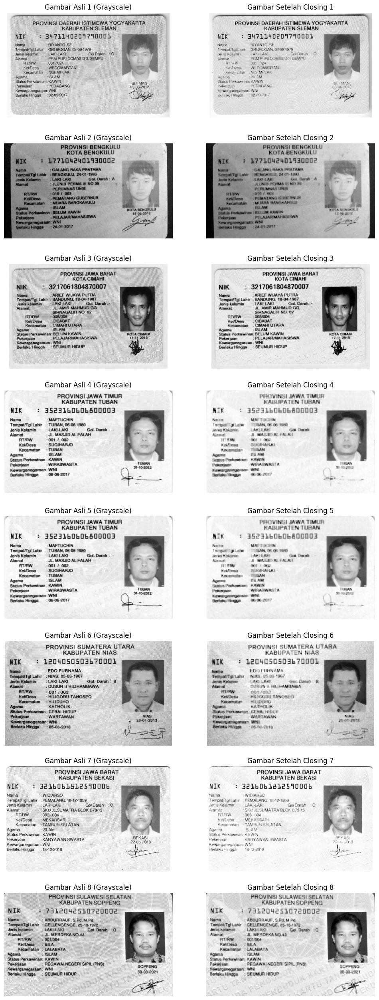

In [27]:
direct_data = '/content/drive/MyDrive/College/05 - Semester 5/PCVK/KTP_More'

# Dapatkan daftar file gambar dalam direktori dataset
image_files = [os.path.join(direct_data, file) for file in os.listdir(direct_data)]

# Inisialisasi subplot untuk menampilkan gambar dalam satu kolom
num_images = len(image_files)

# Set ukuran plot dan kolom
fig, ax = plt.subplots(num_images, 2, figsize=(12, 4*num_images))  # Dua kolom: gambar asli dan gambar setelah Closing

for i, image_path in enumerate(image_files):
    # Baca gambar
    image = cv2.imread(image_path)

    # Ubah gambar menjadi skala abu-abu (grayscale)
    grayscale_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Melakukan operasi Closing pada gambar skala abu-abu
    kernel = np.ones((3, 3), np.uint8)  # Ukuran kernel Closing (bisa disesuaikan)
    closed_image = cv2.morphologyEx(grayscale_image, cv2.MORPH_CLOSE, kernel)

    # Tampilkan gambar asli di subplot pertama
    ax[i, 0].imshow(grayscale_image, cmap='gray')
    ax[i, 0].set_title(f'Gambar Asli {i+1} (Grayscale)')
    ax[i, 0].axis('off')

    # Tampilkan gambar setelah operasi Closing di subplot kedua
    ax[i, 1].imshow(closed_image, cmap='gray')
    ax[i, 1].set_title(f'Gambar Setelah Closing {i+1}')
    ax[i, 1].axis('off')

plt.show()

### TopHat

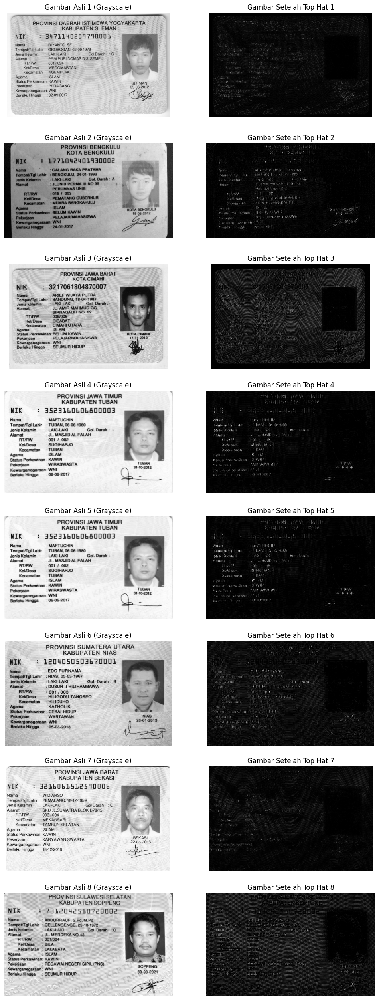

In [28]:
direct_data = '/content/drive/MyDrive/College/05 - Semester 5/PCVK/KTP_More'

# Dapatkan daftar file gambar dalam direktori dataset
image_files = [os.path.join(direct_data, file) for file in os.listdir(direct_data)]

# Inisialisasi subplot untuk menampilkan gambar dalam satu kolom
num_images = len(image_files)

# Set ukuran plot dan kolom
fig, ax = plt.subplots(num_images, 2, figsize=(12, 4*num_images))  # Dua kolom: gambar asli dan gambar setelah Top Hat

for i, image_path in enumerate(image_files):
    # Baca gambar
    image = cv2.imread(image_path)

    # Ubah gambar menjadi skala abu-abu (grayscale)
    grayscale_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Melakukan operasi Top Hat pada gambar skala abu-abu
    kernel = np.ones((3, 3), np.uint8)  # Ukuran kernel Top Hat (bisa disesuaikan)
    top_hat_image = cv2.morphologyEx(grayscale_image, cv2.MORPH_TOPHAT, kernel)

    # Tampilkan gambar asli di subplot pertama
    ax[i, 0].imshow(grayscale_image, cmap='gray')
    ax[i, 0].set_title(f'Gambar Asli {i+1} (Grayscale)')
    ax[i, 0].axis('off')

    # Tampilkan gambar setelah operasi Top Hat di subplot kedua
    ax[i, 1].imshow(top_hat_image, cmap='gray')
    ax[i, 1].set_title(f'Gambar Setelah Top Hat {i+1}')
    ax[i, 1].axis('off')

plt.show()

### BlackHat

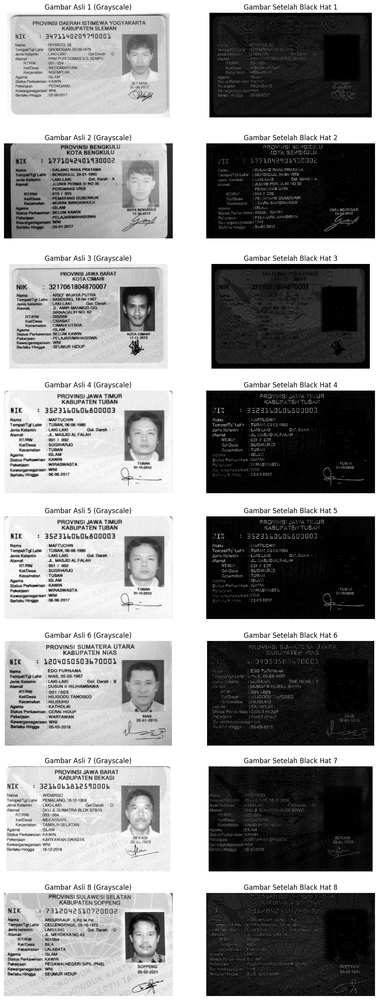

In [29]:
direct_data = '/content/drive/MyDrive/College/05 - Semester 5/PCVK/KTP_More'

# Dapatkan daftar file gambar dalam direktori dataset
image_files = [os.path.join(direct_data, file) for file in os.listdir(direct_data)]

# Inisialisasi subplot untuk menampilkan gambar dalam satu kolom
num_images = len(image_files)

# Set ukuran plot dan kolom
fig, ax = plt.subplots(num_images, 2, figsize=(12, 4*num_images))  # Dua kolom: gambar asli dan gambar setelah Black Hat

for i, image_path in enumerate(image_files):
    # Baca gambar
    image = cv2.imread(image_path)

    # Ubah gambar menjadi skala abu-abu (grayscale)
    grayscale_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Melakukan operasi Black Hat pada gambar skala abu-abu
    kernel = np.ones((3, 3), np.uint8)  # Ukuran kernel Black Hat (bisa disesuaikan)
    black_hat_image = cv2.morphologyEx(grayscale_image, cv2.MORPH_BLACKHAT, kernel)

    # Tampilkan gambar asli di subplot pertama
    ax[i, 0].imshow(grayscale_image, cmap='gray')
    ax[i, 0].set_title(f'Gambar Asli {i+1} (Grayscale)')
    ax[i, 0].axis('off')

    # Tampilkan gambar setelah operasi Black Hat di subplot kedua
    ax[i, 1].imshow(black_hat_image, cmap='gray')
    ax[i, 1].set_title(f'Gambar Setelah Black Hat {i+1}')
    ax[i, 1].axis('off')

plt.show()


## Skeleton

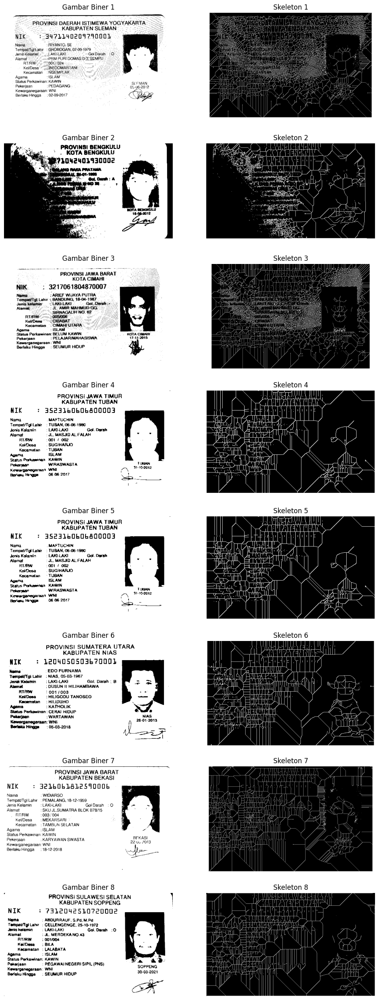

In [30]:
direct_data = '/content/drive/MyDrive/College/05 - Semester 5/PCVK/KTP_More'

# Dapatkan daftar file gambar dalam direktori dataset
image_files = [os.path.join(direct_data, file) for file in os.listdir(direct_data)]

# Inisialisasi subplot untuk menampilkan gambar dalam satu kolom
num_images = len(image_files)

# Set ukuran plot dan kolom
fig, ax = plt.subplots(num_images, 2, figsize=(12, 4*num_images))  # Dua kolom: gambar asli dan gambar skeleton

for i, image_path in enumerate(image_files):
    # Baca gambar
    image = cv2.imread(image_path)

    # Ubah gambar menjadi gambar biner
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    _, binary_image = cv2.threshold(gray_image, 128, 255, cv2.THRESH_BINARY)

    # Hitung skeleton gambar
    skeleton = cv2.ximgproc.thinning(binary_image)

    # Tampilkan gambar asli di subplot pertama
    ax[i, 0].imshow(binary_image, cmap='gray')
    ax[i, 0].set_title(f'Gambar Biner {i+1}')
    ax[i, 0].axis('off')

    # Tampilkan gambar skeleton di subplot kedua
    ax[i, 1].imshow(skeleton, cmap='gray')
    ax[i, 1].set_title(f'Skeleton {i+1}')
    ax[i, 1].axis('off')

plt.show()

### Skeleton Inverse

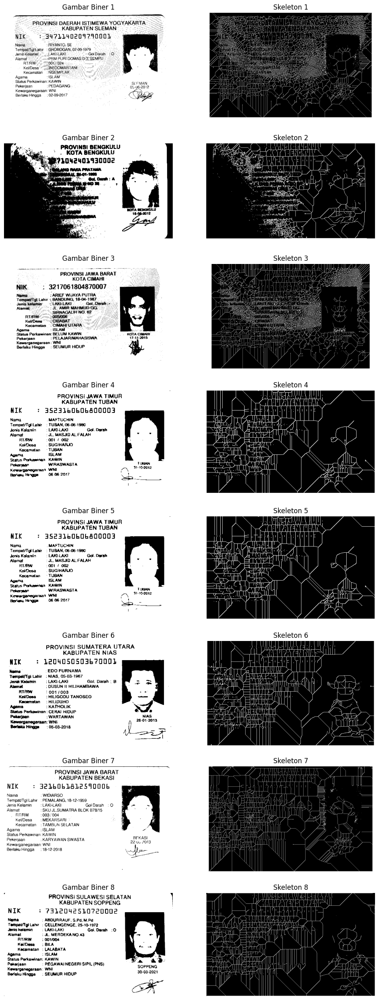

In [31]:
direct_data = '/content/drive/MyDrive/College/05 - Semester 5/PCVK/KTP_More'

# Dapatkan daftar file gambar dalam direktori dataset
image_files = [os.path.join(direct_data, file) for file in os.listdir(direct_data)]

# Inisialisasi subplot untuk menampilkan gambar dalam satu kolom
num_images = len(image_files)

# Set ukuran plot dan kolom
fig, ax = plt.subplots(num_images, 2, figsize=(12, 4*num_images))  # Dua kolom: gambar asli dan gambar skeleton

for i, image_path in enumerate(image_files):
    # Baca gambar
    image = cv2.imread(image_path)

    # Ubah gambar menjadi gambar biner
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    _, binary_image = cv2.threshold(gray_image, 128, 255, cv2.THRESH_BINARY)

    # Hitung skeleton gambar
    skeleton = cv2.ximgproc.thinning(binary_image)

    # Tampilkan gambar asli di subplot pertama
    ax[i, 0].imshow(binary_image, cmap='gray')
    ax[i, 0].set_title(f'Gambar Biner {i+1}')
    ax[i, 0].axis('off')

    # Tampilkan gambar skeleton di subplot kedua
    ax[i, 1].imshow(skeleton, cmap='gray')
    ax[i, 1].set_title(f'Skeleton {i+1}')
    ax[i, 1].axis('off')

plt.show()